In [1]:
import pandas as pd
import numpy as np

import seaborn as sns

sns.set()
import matplotlib.pyplot as plt

# sharper plots
%config InlineBackend.figure_format = 'retina'



---



---

# Data Analysis of US Flight
For this question, the dataset is very large(~1G) so we need to use the google drive to store the data. You need to allow the colab access your google drive. If you feel unsafe to your own personal data, you can create a new google account, simply for the purpose of data analysis.

**Data Description:** The dataset has information about carriers and flights between US airports during the year 2008.
Column description is available [here](https://www.transtats.bts.gov/Fields.asp?gnoyr_VQ=FGJ). Visit this site to find ex. meaning of flight cancellation codes.

Consider the following terms we use:
* unique flight – a record (row) in the dataset
* completed flight – flight that is not cancelled (Cancelled==0 in the dataset)
* flight code – a combination of ['UniqueCarrier','FlightNum'], i.e.  UA52
* airport code – a three letter airport alias from 'Origin or 'Dest' columns

**Data access:** the data is stored in https://drive.google.com/file/d/1kOEcWtcTbbrlhVf1wlYtFQUF_kY92U5O/.

**Load Data:** Once you open the link in the brower, make sure you click the "Add shortcut to Drive" and now your google drive should show up the zip file.  Then you run the following code to link colab to your google drive.




In [2]:
from google.colab import drive
drive.mount('/content/drive')
import os
os.chdir("/content/drive/My Drive")

Mounted at /content/drive


We are not going to read in the whole dataset. In order to reduce memory footprint, we instead load only needed columns and cast them to suitable data types.

In [3]:
dtype = {
    "DayOfWeek": np.uint8,
    "DayofMonth": np.uint8,
    "Month": np.uint8,
    "Cancelled": np.uint8,
    "Year": np.uint16,
    "FlightNum": np.uint16,
    "Distance": np.uint16,
    "UniqueCarrier": str,
    "CancellationCode": str,
    "Origin": str,
    "Dest": str,
    "ArrDelay": np.float32,
    "DepDelay": np.float32,
    "CarrierDelay": np.float32,
    "WeatherDelay": np.float32,
    "NASDelay": np.float32,
    "SecurityDelay": np.float32,
    "LateAircraftDelay": np.float32,
    "DepTime": np.float32,
}
flights_df = pd.read_csv("flights_2008.csv.bz2", usecols=dtype.keys(), dtype=dtype)

In [4]:
print(flights_df.shape)
print(flights_df.columns)

(7009728, 19)
Index(['Year', 'Month', 'DayofMonth', 'DayOfWeek', 'DepTime', 'UniqueCarrier',
       'FlightNum', 'ArrDelay', 'DepDelay', 'Origin', 'Dest', 'Distance',
       'Cancelled', 'CancellationCode', 'CarrierDelay', 'WeatherDelay',
       'NASDelay', 'SecurityDelay', 'LateAircraftDelay'],
      dtype='object')


In [5]:
# Print first 5 rows of the dataset
flights_df.head()

,Year,Month,DayofMonth,DayOfWeek,DepTime,UniqueCarrier,FlightNum,ArrDelay,DepDelay,Origin,Dest,Distance,Cancelled,CancellationCode,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
0,2008,1,3,4,2003.0,WN,335,-14.0,8.0,IAD,TPA,810,0,NaN,NaN,NaN,NaN,NaN,NaN
1,2008,1,3,4,754.0,WN,3231,2.0,19.0,IAD,TPA,810,0,NaN,NaN,NaN,NaN,NaN,NaN
2,2008,1,3,4,628.0,WN,448,14.0,8.0,IND,BWI,515,0,NaN,NaN,NaN,NaN,NaN,NaN
3,2008,1,3,4,926.0,WN,1746,-6.0,-4.0,IND,BWI,515,0,NaN,NaN,NaN,NaN,NaN,NaN
4,2008,1,3,4,1829.0,WN,3920,34.0,34.0,IND,BWI,515,0,NaN,2.0,0.0,0.0,0.0,32.0


In [6]:
# Examine data types of all features and total dataframe size in memory
flights_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7009728 entries, 0 to 7009727
Data columns (total 19 columns):
 #   Column             Dtype  
---  ------             -----  
 0   Year               uint16 
 1   Month              uint8  
 2   DayofMonth         uint8  
 3   DayOfWeek          uint8  
 4   DepTime            float32
 5   UniqueCarrier      object 
 6   FlightNum          uint16 
 7   ArrDelay           float32
 8   DepDelay           float32
 9   Origin             object 
 10  Dest               object 
 11  Distance           uint16 
 12  Cancelled          uint8  
 13  CancellationCode   object 
 14  CarrierDelay       float32
 15  WeatherDelay       float32
 16  NASDelay           float32
 17  SecurityDelay      float32
 18  LateAircraftDelay  float32
dtypes: float32(8), object(4), uint16(3), uint8(4)
memory usage: 494.7+ MB





Here are simples tasks to further understand this dataset first.




---



---



## 1.1

Count unique Carriers and plot their relative share of flights

In [8]:
a = flights_df['UniqueCarrier']
a

0          WN
1          WN
2          WN
3          WN
4          WN
           ..
7009723    DL
7009724    DL
7009725    DL
7009726    DL
7009727    DL
Name: UniqueCarrier, Length: 7009728, dtype: object

UniqueCarrier
WN    1201754
AA     604885
OO     567159
MQ     490693
US     453589
DL     451931
UA     449515
XE     374510
NW     347652
CO     298455
EV     280575
9E     262208
FL     261684
YV     254930
OH     197607
B6     196091
AS     151102
F9      95762
HA      61826
AQ       7800
Name: count, dtype: int64


<Axes: xlabel='UniqueCarrier'>

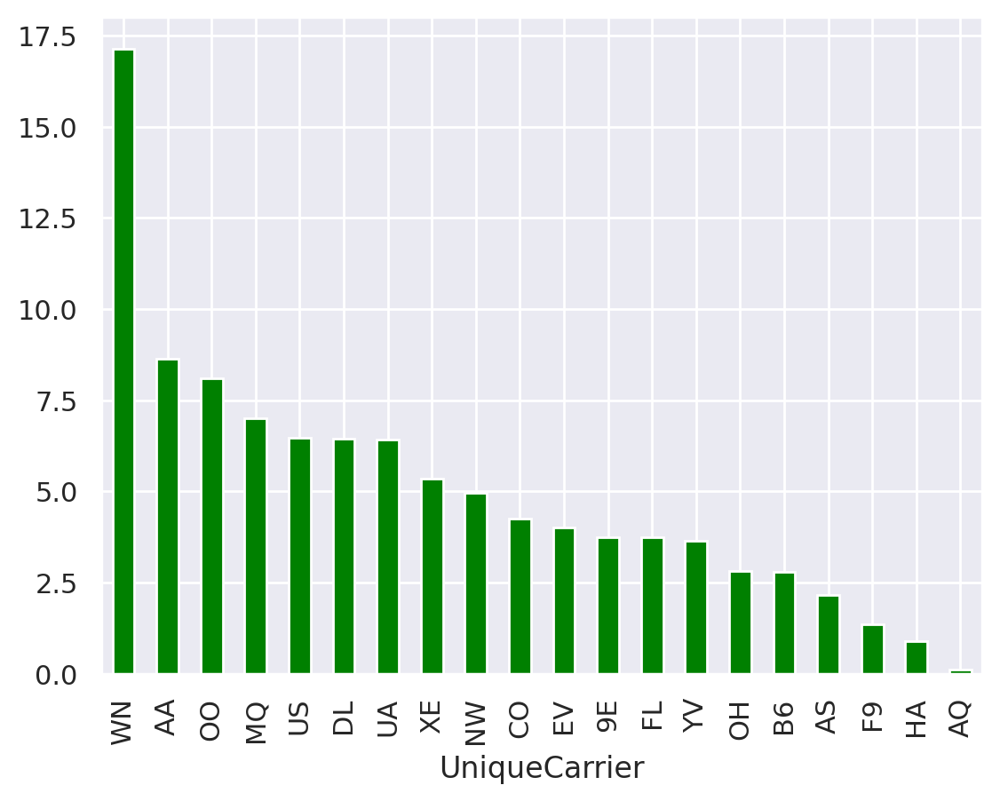

In [9]:
c1 = flights_df["UniqueCarrier"].value_counts()
print(c1)
c2 = (c1/c1.sum())*100
c2.plot(kind="bar", color="green")




```
# This is formatted as code
```

First, we use the value_counts method to count each individual object in the "Unique Carrier" column. Then, we calculate the ratio of the count of each object to the total count. We do this to determine the proportion of each object relative to the total number of flights. Finally, we use the plot command with the 'bar' type to draw a bar chart illustrating this distribution.



---


## 1.2

Finding top-3 flight codes, that have the largest total distance traveled in year 2008



In [ ]:
flights_df['FlightCode']=flights_df['UniqueCarrier']+flights_df['FlightNum'].astype(str)
f1 = flights_df[flights_df["Year"]==2008]
f2 = f1.groupby('FlightCode')['Distance'].sum()
f3 = f2.sort_values(ascending=False).head(3)
f3
for i, (flight_code, total_distance) in enumerate(f3.items(), start=1):
  print(f"Number {i}: Flight Code {flight_code} with total distance {total_distance}")


Number 1: Flight Code CO15 with total distance 1796244
Number 2: Flight Code CO14 with total distance 1796244
Number 3: Flight Code UA52 with total distance 1789722


### Your Answer to Q1.2:
First I created a new column "FlightCode" and I put its values equal to the sum of the values of 'UniqueCarrier' and 'FlightNum', Because flight code is a combination of 'UniqueCarrier' and 'FlightNum'. Then, I separate a portion of the dataset related to the year 2008 and assign it to the variable f1. Then, I use groupby and sum to calculate the total distance traveled for each flight code(assign it to the variable f2). I sorted the data in descending order to find the three flight codes with the highest total distance(assign it to the variable f3). Finally, I shows that top-3 flight codes, that have the largest total distance traveled in year 2008.









---


## Q1.3

Find number of flights by days of week and months and use imshow to plot this table



   DayOfWeek  Number of Flight
0          1           1036201
1          2           1032049
2          3           1039665
3          4           1032224
4          5           1035166
5          6            857536
6          7            976887
    DayofMonth  Number of Flight
0            1            229292
1            2            230865
2            3            233259
3            4            228649
4            5            228156
5            6            228117
6            7            233797
7            8            229578
8            9            227064
9           10            232989
10          11            233448
11          12            227247
12          13            227233
13          14            234285
14          15            230379
15          16            229085
16          17            233202
17          18            234146
18          19            227487
19          20            229165
20          21            234533
21          22            

([<matplotlib.axis.YTick at 0x7c9f348ceb00>,
 [Text(0, 0, '1'),
  Text(0, 1, '2'),
  Text(0, 2, '3'),
  Text(0, 3, '4'),
  Text(0, 4, '5'),
  Text(0, 5, '6'),
  Text(0, 6, '7'),
  Text(0, 7, '8'),
  Text(0, 8, '9'),
  Text(0, 9, '10'),
  Text(0, 10, '11'),
  Text(0, 11, '12')])

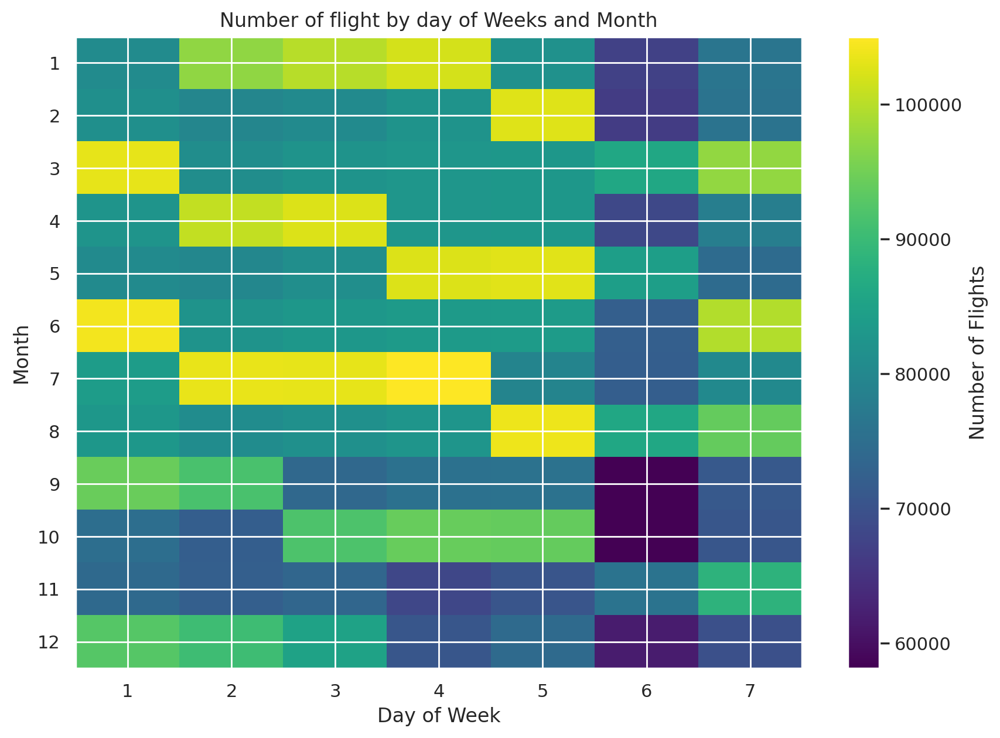

In [ ]:
a1 = flights_df.groupby('DayofMonth').size().reset_index(name = 'Number of Flight')
a2 = flights_df.groupby('DayOfWeek').size().reset_index(name = 'Number of Flight')
print(a2)
print(a1)
a3 = flights_df.groupby(['Month','DayOfWeek']).size().unstack()
a4 = a3.values
plt.figure(figsize=(10,7))
plt.imshow(a4, cmap='viridis', aspect='auto')
plt.colorbar(label='Number of Flights')
plt.title('Number of flight by day of Weeks and Month')
plt.xlabel('Day of Week')
plt.ylabel('Month')
plt.xticks(np.arange(a3.columns.size),a3.columns)
plt.yticks(np.arange(a3.index.size), a3.index)

### Your Answer to Q1.3:
First, I group the relevant data on a weekly and monthly basis using the groupby command. Then, using the size command, I calculate the number of flights for each day of the week and month, and label them as "Number of Flights." This allows us to calculate the number of flights on weekdays and months. Next, in order to calculate the number of days in a month and in a week, I obtained their counts using groupby. Subsequently, I stored these values in the variable 'a4'. I specified their color spectrum for charting using the 'cmap' command. Finally, I utilized arrays in numpy to plot the days in a week against the days in a month, with the horizontal axis representing days in a week and the vertical axis representing days in a month.














---

## Q1.4

We have both cancelled and completed flights in the dataset.
Check if there are more completed or cancelled flights. What is the difference?

In [ ]:
c0 = flights_df[flights_df['Cancelled']==0].shape[0]
c1 = flights_df[flights_df['Cancelled']==1].shape[0]
d = c0 - c1
print("Difference between Completed and cancelled flights is : ",d)

Difference between Completed and cancelled flights is :  6734860


### Your Answer to Q1.4:
First, we define two variables, c0 and c1, to find the number of completed and cancelled flights. I set the shape to zero in each to only calculate those specific rows. Then, using the variable d, I calculate the difference between c0 and c1, indicating the contrast between completed and cancelled flights. It shows that the number of completed flights is greater than the cancelled ones.









---

## Q1.5
Find the carrier that has the greatest number of cancelled flights.



In [ ]:
c = flights_df[flights_df['Cancelled']==1].groupby('UniqueCarrier').size()
cmax = c.max()
cindex = c[c==cmax].index.to_list()
print(cindex[0], " is the carrier has ", cmax, " number of cancellation.")


MQ  is the carrier has  18331  number of cancellation.


### Your Answer to Q1.5:
First, I define a variable, c, to calculate the number of cancelled flights with respect to the "UniqueCarrier" column. I set the value of cancelled to 1 and group them by the "UniqueCarrier" column. Then, using the size command, I calculate the number of cancelled flights for each carrier. Using the max command, I find the maximum number of cancellations and identify the corresponding carrier. Finally, I print the results.









---
## Q1.6
 1. Plot distributions of flight cancellation reasons (CancellationCode).
 2. What is the most frequent reason for flight cancellation?

 (Use this (https://www.transtats.bts.gov/Fields.asp?Table_ID=236) to translate codes into reasons)



the most frequent reason for flight cancellation is:  Weather


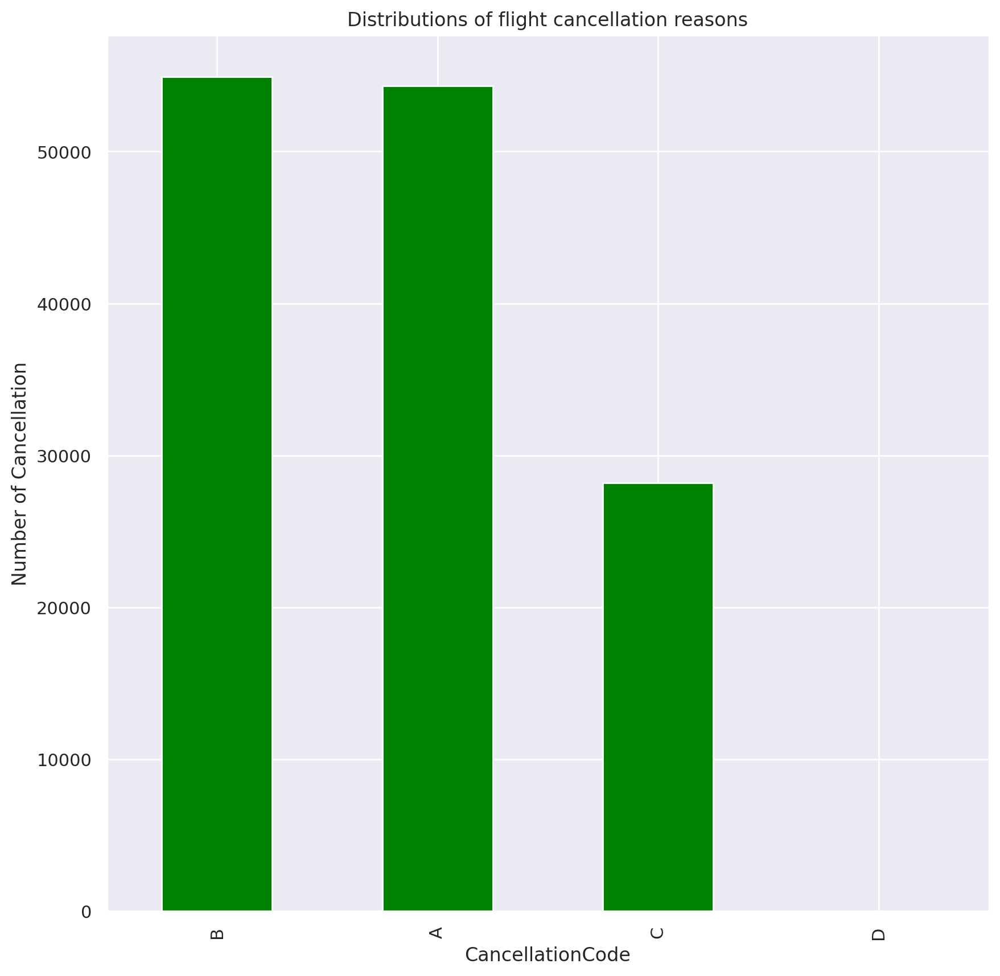

In [ ]:
a = flights_df['CancellationCode'].value_counts()
plt.figure(figsize=(10,10))
a.plot(kind='bar', color='green')
plt.title('Distributions of flight cancellation reasons')
plt.xlabel('CancellationCode')
plt.ylabel('Number of Cancellation')
Reasons = {'A':'Carrier','B':'Weather', 'C':'National Airspace System','D':'Security'}
m1 = flights_df['CancellationCode'].mode().iloc[0]
m2 = Reasons.get(m1,'NaN')
print("the most frequent reason for flight cancellation is: ",m2)

### Your Answer to Q1.6:

I defined variable a to find the count of each unique value in the 'CancellationCode' column. Then, I used the plot and bar commands to draw a histogram and visualize the data distribution. Next, I created a dictionary called Reasons to translate the codes into reasons.

With the variable m1, I found the mode of the data in the 'CancellationCode' column, and using iloc[0], I considered the first value. Then, I defined m2 to find the highest frequency in m1. Finally, I printed it in the output(the most frequent reason for flight cancellation is:  Weather).










---


## Q1.7
 We'll need a new column in our dataset - departure hour
 `DepTime` is distributed from 1 to 2400 (it is given in the `hhmm` format.
 We'll treat departure hour as `DepTime` // 100 (divide by 100 and apply the `floor` function).
 However, now we'll have both hour 0 and hour 24.
 Hour 24 sounds strange, we'll set it to be 0 instead (a typical imperfectness of real data, however, you can check that it affects only 521 rows, which is sort of not a big deal).
 So now values of a new column `DepHour` will be distributed from 0 to 23.
 There are some missing values, for now we won't fill in them, just ignore them.


In [ ]:
flights_df['DepHour'] = flights_df['DepTime'] // 100
flights_df['DepHour'] = flights_df['DepHour'].replace(24,0)
flights_df[['DepTime','DepHour']].head()

,DepTime,DepHour
0,2003.0,20.0
1,754.0,7.0
2,628.0,6.0
3,926.0,9.0
4,1829.0,18.0


### Your Answer to Q1.7:
First, I add a new column, 'DepHour,' to the dataset, and its values are set equal to the values in the 'DepTime' column divided by 100. Since we are asked to replace the values of 24 with 0, we use the replace command for this purpose. Then, using the head command, we print the first 5 values of the 'DepHour' and 'DepTime' columns in the output.










---
## Q1.8:
 Which route is the most frequent, in terms of the number of flights?
 Take a look at 'Origin' and 'Dest' features. Consider A->B and B->A directions as different routes)


In [ ]:
new = pd.DataFrame()
new['Routes'] = flights_df['Origin'] + flights_df['Dest']
m = new.value_counts()
mindex = m.idxmax()
r0 = mindex[0]
r1 = ""
r2 = ""
for i in range(0,3):
  r1 = r1 + r0[i]
for i in range(3,6):
  r2 = r2 + r0[i]
print(r1, " to ", r2, "is the most frequent route, in terms of the number of flights.")


SFO  to  LAX is the most frequent route, in terms of the number of flights.


### Your Answer to Q1.8:
I first created a new DataFrame to store all routes. These routes are the result of adding the two columns 'Origin' and 'Dest'. Then, I counted the occurrences of each unique element in this new DataFrame to see which route had the most flights. Afterward, I broke down the 6-character string to clearly indicate in the output which route had the highest number of flights.









---
## Q1.9:
1. Find top-5 delayed routes (count how many times they were delayed on departure).
2. From all flights on these 5 routes, count all flights with weather conditions contributing to a delay.
Consider only positive delays.


In [ ]:
new['Delay'] = flights_df['DepDelay']
top5 = new.groupby('Routes')['Delay'].sum().sort_values(ascending=False)
print("Top-5 delayed routes: ")
print(top5.head(5))
print("-------------")
new["WPD"] = (flights_df["WeatherDelay"]>0)
top5 = top5.head(5).index
f = new[new['Routes'].isin(top5)]
WD = f[f['WPD']==1].shape[0]
print("Number of Flight that have delayed because weather: ",WD)


Top-5 delayed routes: 
Routes
ORDLGA    226044.0
ORDEWR    221793.0
LAXSFO    208841.0
ATLEWR    184141.0
LGAORD    175950.0
Name: Delay, dtype: float32
-------------
Number of Flight that have delayed because weather:  832


### Your Answer to Q1.9:
I first utilized the DataFrame created in the previous question (named 'new') and added the 'DepDelay' column to it. Then, I grouped it by two columns, 'Routes' and 'Delay,' using the groupby command. I used the sum command to calculate the total delay for each route. I sorted all routes in descending order based on their delay to display the top 5 routes with the highest delays. Afterward, I considered a new column for 'new' and assigned its values to be equal to the positive values in the 'WeatherDelay' column.
Then we calculate the indices of the top 5 routes and use the filter 'f' to identify rows that have the correct values in the 'Routes' column and are in the top 5. Next, we select rows from 'WPD' where the values are positive, calculate the total number of rows with shape[0], assign it to 'WD,' and finally print it in the output.















---

## Q1.10:
Let's examine departure time and consider distribution by hour (column `DepHour` that we've created earlier).
1. Which hour has the highest percentage of flights?
2. Which hour has the least percentage of cancelled flights?


In [ ]:
t = len(flights_df)
f = flights_df['DepHour'].value_counts()
p = (f/t)*100
h = p.idxmax()
p2 = p.max()
c = flights_df[flights_df['Cancelled']==1]['DepHour'].value_counts()
p3 = (c/f)*100
h2 = p3.idxmin()
p4 = p3.min()
print("hour has the highest percentage of flights: ",h)
print("hour has the least percentage of cancelled flights: ",h2)

hour has the highest percentage of flights:  8.0
hour has the least percentage of cancelled flights:  13.0


### Your Answers to Q1.10
First, I calculated the total number of flights, both canceled and not canceled, using the len command. Then, I defined a variable f to count the number of flights by hour. Next, I calculated their percentage of the total and stored it in variable p. Using the idxmax command, I calculated the hour with the highest percentage of flights and stored it in variable h. Afterwards, I calculated the number of canceled flights by hour and figured out their percentage. Finally, with the idxmin command, I calculated the hour with the lowest percentage of canceled flights and printed the required values in the output.














---


## Q1.11
Since we know the departure hour, it might be interesting to examine the average delay for corresponding hour.
1. Are there any cases, when the planes on average departed earlier than they should have done?
2. And if yes, at what departure hours did it happen?


In [ ]:
avg = flights_df.groupby('DepHour')['DepDelay'].mean()
d = avg[avg<0].index
d = d.to_list()
print("Departure hours did it are : ")
for i in d:
  print(i)

Departure hours did it are : 
5.0
6.0


### Your Answers to Q1.11
First, I group the columns DepHour and DepDelay together to be able to calculate their mean using the mean function. I considered those instances where the average was less than zero, and calculated their indices, storing them in the variable d. Then, I converted the variable d to a list and used a for loop to print its elements, which represent the hours when flights departed earlier than the mean.










---

## Q1.12
Examine the distribution of cancellation reasons with time. Make a bar plot of cancellation reasons aggregated by months.



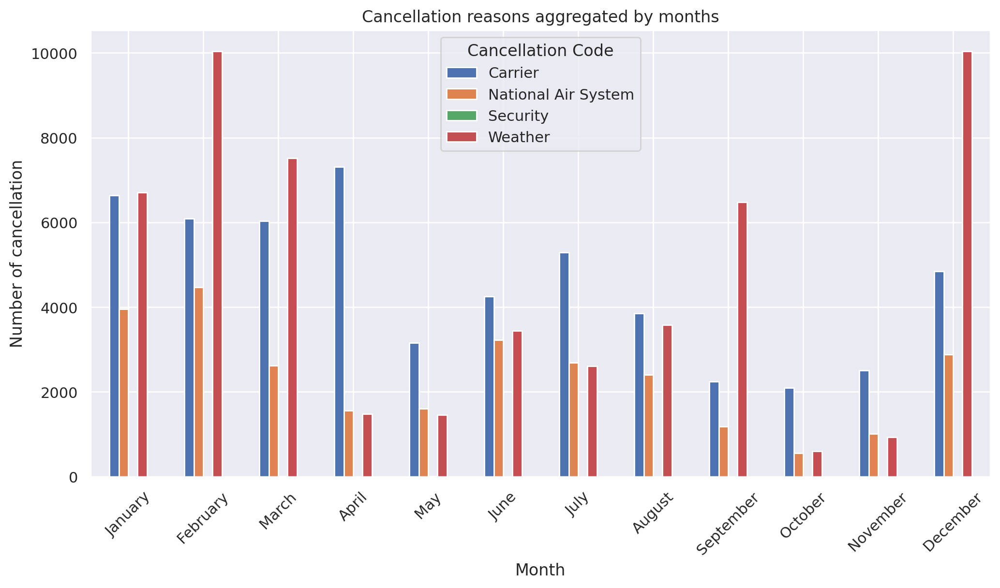

In [ ]:
import calendar
D = {'A':'Carrier','B': 'Weather', 'C':'National Air System', 'D':'Security'}
flights_df['CancellationReason']=flights_df['CancellationCode'].map(D)
c = flights_df.groupby(['Month', 'CancellationReason']).size().unstack()
c.plot(kind='bar',figsize=(12,6))
plt.title('Cancellation reasons aggregated by months')
plt.xlabel('Month')
plt.ylabel('Number of cancellation')
plt.xticks(ticks=range(12), labels=[calendar.month_name[i+1] for i in range(12)], rotation=45)
plt.legend(title='Cancellation Code')



### Your Answers to Q1.12
At first, I map cancellation codes like 'A', 'B', 'C', 'D' to their corresponding textual reasons using a dictionary. Then, I aggregates data by month and cancellation reason. It groups the data by 'Month' and the translated cancellation reason, then counts the number of occurrences in each group using .size(). This results in the count of cancellations for each reason in each month. Finally, the code plots a bar chart of the number of cancellations for each reason in each month. The plot is configured to have month names as the x-axis labels and the number of cancellations as the y-axis labels, with each bar representing the count of cancellations for a specific reason in a specific month. Month names are translated using the calendar library for better readability.



---


## 1.13
Examine median arrival and departure delays (in time) by carrier.

1. Which carrier has the lowest median delay time for both arrivals and departures? Leave only non-negative values of delay times ('ArrDelay', 'DepDelay').
2. Use ([Boxplots](https://seaborn.pydata.org/generated/seaborn.boxplot.html) to plot ArrDelay vs Carrier and DepDelay vs Carrier.



Carrier with the lowest median delay time for both arrivals and departures is:  AQ


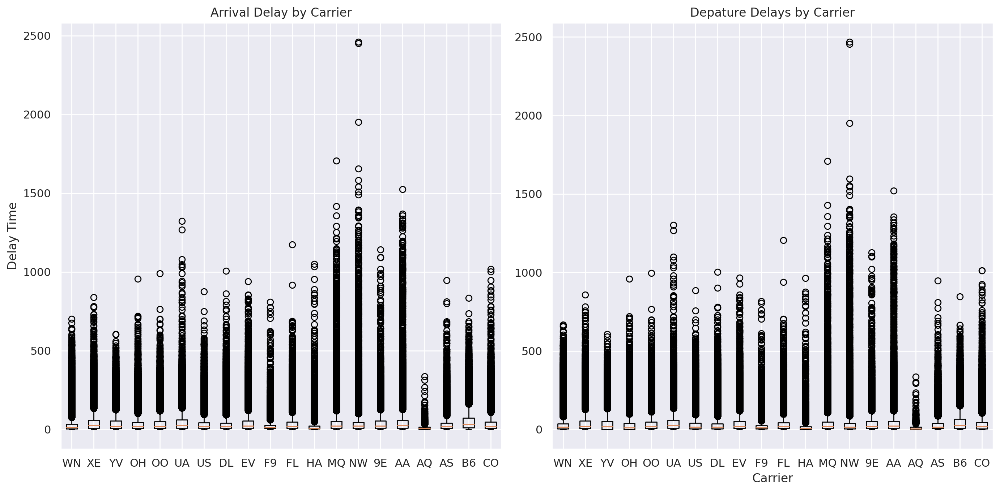

In [ ]:
n = flights_df[(flights_df['ArrDelay']>=0) & (flights_df['DepDelay']>=0)]
m = n.groupby('UniqueCarrier')[['ArrDelay','DepDelay']].median()
l1 = m.mean(axis=1).idxmin()
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14,7))
axes[0].boxplot([n[n['UniqueCarrier']==carrier]['ArrDelay'] for carrier in n['UniqueCarrier'].unique()], labels=n['UniqueCarrier'].unique())
axes[0].set_title('Arrival Delay by Carrier')
axes[0].set_ylabel('Delay Time')
axes[1].boxplot([n[n['UniqueCarrier']==carrier]['DepDelay'] for carrier in n['UniqueCarrier'].unique()], labels=n['UniqueCarrier'].unique())
axes[1].set_title('Depature Delays by Carrier')
axes[1].set_xlabel('Carrier')
plt.tight_layout()
print("Carrier with the lowest median delay time for both arrivals and departures is: ", l1)

### Your Answers to Q1.13
First, I removed the data with negative delays to consider only actual delays (positive or zero). Then, for each carrier, I calculated the median of ArrDelay and DepDelay. Next, I identified the airline that has the lowest average median delay for both types of delays. Afterward, I created two box plots for each of them. For each airline, I created a list of arrival delays related to that airline.
labels = df_filtered['UniqueCarrier'].unique() sets the x-axis labels to the unique names of airline companies. The line located in the middle of the boxes represents the median of the data. The median is a point that divides the data into two equal halves. By looking at both figure, we can approximately determine that AQ is the Carrier with the lowest median delay time for both arrivals and departures.






# Q2: Video Sale

We picked a dataset on video game sales and ratings from [Video Game Sales with Ratings](https://www.kaggle.com/datasets/rush4ratio/video-game-sales-with-ratings). Some of the games in this dataset lack ratings; so, let’s filter for only those examples that have all of their values present.



In [ ]:
!wget https://raw.githubusercontent.com/yexf308/PracticalML/main/data/video_games_sales.csv?raw=true -O video_games_sales.csv


--2024-02-02 03:19:06--  https://raw.githubusercontent.com/yexf308/PracticalML/main/data/video_games_sales.csv?raw=true
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1618040 (1.5M) [text/plain]
Saving to: ‘video_games_sales.csv’

video_games_sales.c 100%[===================>]   1.54M  --.-KB/s    in 0.06s   

2024-02-02 03:19:06 (24.1 MB/s) - ‘video_games_sales.csv’ saved [1618040/1618040]



In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()

# Graphics in SVG format are more sharp and legible
%config InlineBackend.figure_format = 'svg'

# Increase the default plot size and set the color scheme
plt.rcParams["figure.figsize"] = (8, 5)
plt.rcParams["image.cmap"] = "viridis"

In [ ]:
# Load the data into a pandas dataframe and droped NA data entry
df = pd.read_csv("video_games_sales.csv").dropna()
print(df.shape)

(6825, 16)


In [ ]:
# Next, print the summary of the DataFrame to check data types and to verify everything is non-null.
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6825 entries, 0 to 16706
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             6825 non-null   object 
 1   Platform         6825 non-null   object 
 2   Year_of_Release  6825 non-null   float64
 3   Genre            6825 non-null   object 
 4   Publisher        6825 non-null   object 
 5   NA_Sales         6825 non-null   float64
 6   EU_Sales         6825 non-null   float64
 7   JP_Sales         6825 non-null   float64
 8   Other_Sales      6825 non-null   float64
 9   Global_Sales     6825 non-null   float64
 10  Critic_Score     6825 non-null   float64
 11  Critic_Count     6825 non-null   float64
 12  User_Score       6825 non-null   object 
 13  User_Count       6825 non-null   float64
 14  Developer        6825 non-null   object 
 15  Rating           6825 non-null   object 
dtypes: float64(9), object(7)
memory usage: 906.4+ KB
None


In [ ]:
df["User_Count"]

0        322.0
2        709.0
3        192.0
6        431.0
7        129.0
         ...  
16667     21.0
16677      9.0
16696    412.0
16700     43.0
16706     13.0
Name: User_Count, Length: 6825, dtype: float64

In [ ]:
df["User_Score"]

0          8
2        8.3
3          8
6        8.5
7        6.6
        ... 
16667    2.4
16677    8.8
16696    7.6
16700    5.8
16706    7.2
Name: User_Score, Length: 6825, dtype: object

## Q2.1
We see that pandas has loaded some of the numerical features as object type.
1. What are these features?

2. We will explicitly convert those columns into float and int.

In [ ]:
n = df.select_dtypes(include='object').columns.to_list()
numeric_columns = []
for i in n:
  check = pd.to_numeric(df[i], errors='coerce').notna().any()
  if check:
    numeric_columns.append(i)
df['User_Score'] = df['User_Score'].astype(float)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6825 entries, 0 to 16706
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             6825 non-null   object 
 1   Platform         6825 non-null   object 
 2   Year_of_Release  6825 non-null   float64
 3   Genre            6825 non-null   object 
 4   Publisher        6825 non-null   object 
 5   NA_Sales         6825 non-null   float64
 6   EU_Sales         6825 non-null   float64
 7   JP_Sales         6825 non-null   float64
 8   Other_Sales      6825 non-null   float64
 9   Global_Sales     6825 non-null   float64
 10  Critic_Score     6825 non-null   float64
 11  Critic_Count     6825 non-null   float64
 12  User_Score       6825 non-null   float64
 13  User_Count       6825 non-null   float64
 14  Developer        6825 non-null   object 
 15  Rating           6825 non-null   object 
dtypes: float64(10), object(6)
memory usage: 906.4+ KB


### Your Answer to Q2.1:
First, we define the variable n to store the column names that are stored as objects using select_dtype. Then, using a for loop, we iterate through the columns stored as objects to check whether the data in these columns are numeric or not. We perform this check using the to_numeric command. Next, we store the columns that contain numbers in the numeric_columns list. By checking the numeric_columns list, we determine that the "User_Score" and "Developer" columns contains numeric data stored as objects. But when I check the data of these columns using info command, I realized that the only columns that I have to chenge its type is "User_Score".  Now, based on the numerical format in this column, we set the type of this column to float.









---
## Q2.2
1. Create a plot of video game sales by country and year.
2. What can you tell from the plot?


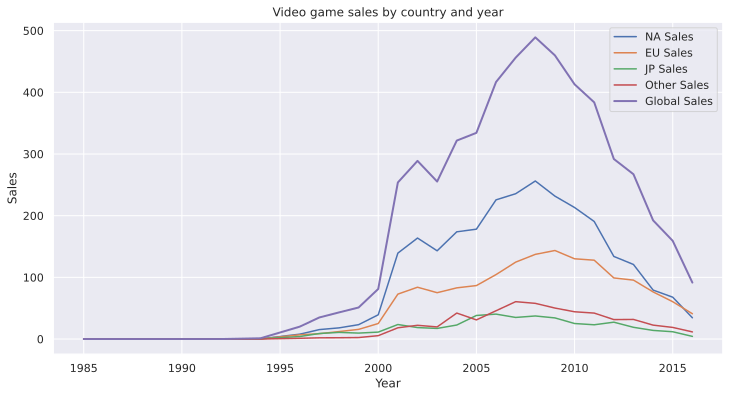

In [ ]:
p = df.groupby('Year_of_Release')[['NA_Sales','EU_Sales','JP_Sales','Other_Sales','Global_Sales']].sum()
plt.figure(figsize=(12,6))
plt.plot(p.index, p['NA_Sales'], label = 'NA Sales')
plt.plot(p.index, p['EU_Sales'], label = 'EU Sales')
plt.plot(p.index, p['JP_Sales'], label = 'JP Sales')
plt.plot(p.index, p['Other_Sales'], label = 'Other Sales')
plt.plot(p.index, p['Global_Sales'], label = 'Global Sales', linewidth=2)
plt.title('Video game sales by country and year')
plt.xlabel('Year')
plt.ylabel('Sales')
plt.legend()
plt.grid(True)


### Your answer to Q2.2:
In the beginning, between the years 1995 to 2000, we observe relatively uniform sales across various countries worldwide. However, from the year 2000 to 2015, we notice a significant increase in sales in NA (North America) and EU (Europe) compared to other countries. During these years, there is not a notable increase in game sales in JP (Japan) and other countries, and they remain at approximately the same level. Game sales reached their peak in NA and EU between 2005 and 2010, holding the largest share in the global sales increase. This might be due to the popularity of games in these regions. From 2010 onwards, we witness a decline in game sales in all countries.
Overall, by observing this chart, we've understood that NA (North America) and EU (Europe) have the most significant impact on the global increase in game sales. Therefore, we can work on considering other features and their effects to further enhance global sales.
###with this plot:
1- You can compare the sales of video games in different years and in different countries
2- You can see noticeable changes over the years, for example, a popular game may have been released that year.
3- You can see the popularity of video games in different years and in different countries.














---
## Q2.3
1. Create a pairwise relationships plot for `Global_Sales`, `Critic_Score`, `Critic_Count`, `User_Score`, `User_Count`.

2. What can you tell from the plot?



In [ ]:
a1 = ['Global_Sales', 'Critic_Score', 'Critic_Count', 'User_Score', 'User_Count']
a2 = df[a1]
sns.set_style('whitegrid')
sns.pairplot(a2)

### Your answer to Q2.3:
This plot defines the pairwise relationships between features. For example, we can see a positive relationship between critic scores and critic counts. It shows that games reviewed by more critics tend to have higher scores. There is a weak correlation between global sales and critic scores. In this case, high critic scores don't necessarily translate to high global sales, but very low-scoring games rarely achieve high sales. The relationship between user scores and critic counts is not completely apparent. In this case, games with higher user counts tend to have moderately high user scores. This plot shows that the distributions of each features. For example, We can see that critic scores tend to be normally distributed, while user scores, critic counts, and user counts are more skewed.










---

## Q2.4
1. Plot a distribution of observations critics’ ratings.

2. Perform some statistical analysis on the feature. What can you tell from it?


count    6825.000000
mean       70.272088
std        13.868572
min        13.000000
25%        62.000000
50%        72.000000
75%        80.000000
max        98.000000
Name: Critic_Score, dtype: float64
Kurtosis is:  0.3959180324919731
Skewness is:  -0.7457682733421854


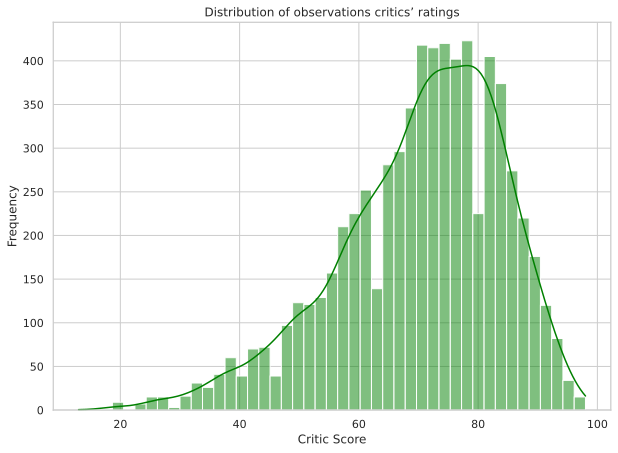

In [ ]:
# ignore missing values
a = df.dropna(subset=['Critic_Score'])
plt.figure(figsize=(10,7))
sns.histplot(a['Critic_Score'], kde=True, color='green')
plt.title('Distribution of observations critics’ ratings')
plt.xlabel('Critic Score')
plt.ylabel('Frequency')
plt.grid(True)
####
a1 = a['Critic_Score'].describe()
print(a1)
a4 = a['Critic_Score'].kurtosis()
print("Kurtosis is: ", a4)
a5 = a['Critic_Score'].skew()
print("Skewness is: ", a5)

### Your answer to Q2.4:
With the Mean value, we can determine central tendency, and this number indicates a moderate average rating across games. Min and Max demonstrate that wide range of domain in Critic_Score. When we see the value of quartiles, we realize that half of the games have a rating between 62 and 80(because The 25th percentile is at 62, the median is at 72, and the 75th percentile is at 80). the skewness is -0.74 and it shows that there is a longer tail on the end of the score range. the Kurtosis is 0.39 and it shows that a relatively normal distribution in terms of peakiness.
###with this analize:
I realize that most games receive moderate rating, indicating a tendency for scores slightly above the mean. the disturbution shows that there is moderate variability in Critic_Score across various games. The slight leftward skew of the distribution suggests that there are fewer games with extremely low ratings in comparison to those with very high ratings.



---

## Q2.5:
To look more closely at the relationship between two numerical variables,

1. use jointplot to see how the `Critic_Score` and `User_Score` features are related.

2. What can you tell from it?

Text(0.5, 1.02, 'The relation between Critic_Score and User_Score')

<Figure size 1000x600 with 0 Axes>

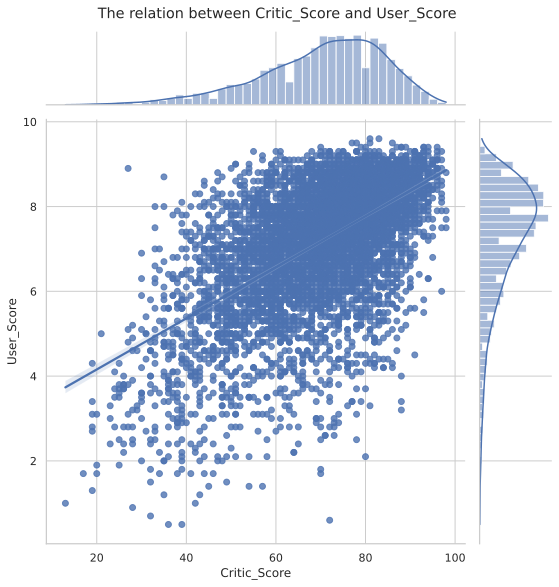

In [ ]:
a = df.dropna(subset=['Critic_Score','User_Score'])
sns.set(style='whitegrid')
plt.figure(figsize=(10,6))
sns.jointplot(x='Critic_Score', y='User_Score', data=a, kind='reg', height=8)
plt.suptitle('The relation between Critic_Score and User_Score', y=1.02)

### Your answer to Q2.5:
In general, I realized that Critic_Score and User_Score have a positive correlation. This means that, in general, games that receive high ratings from critics are also positively received by users, and vice versa. But we can see a few discrepancies. The histogram plot on top shows that a normally distributed with a slight left skew on critic Score, and the second histogram on right shows that greater variability in user ratings and a tendency for lower scores when compared to critic ratings. There are games with high critic scores but lower user scores, and conversely, which highlights differences in opinion between critics and users for specific games. I use kind='reg' command because I wanted to see the slop of regression line. The slope of line is positive so it shows that positive correlation.





  



---


## Q2.6
1. Use Boxplot compare critics’ ratings for the top 5 biggest gaming platforms.
2. What can you tell from it?



Text(0, 0.5, 'Critic Score')

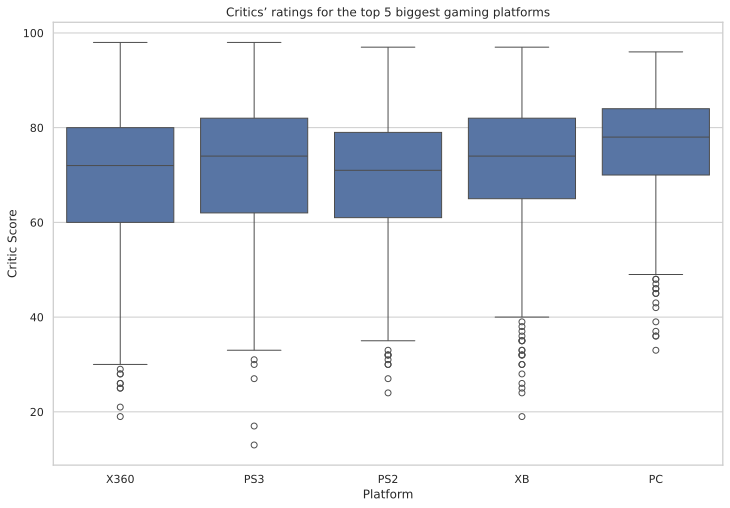

In [ ]:
top = df['Platform'].value_counts().head(5).index
a1 = df[df['Platform'].isin(top)]
plt.figure(figsize=(12,8))
sns.boxplot(x='Platform', y='Critic_Score', data=a1)
plt.title('Critics’ ratings for the top 5 biggest gaming platforms')
plt.xlabel('Platform')
plt.ylabel('Critic Score')

### Your answer to Q2.6:
On each platform, you can see a range of ratings, with the median represented by the line in the middle of each box. Each median shows that different average levels of game quality among platforms. Some platforms may have higher overall median scores, indicating generally more favorable reviews. The length of the boxes shows that the spread and range of ratings for each platform. A taller box indicates greater variability in critic scores. We can see outliers(points outsides). These are games that have critic scores significantly higher or lower than the typical range for that platform. Finally, this plot help us to understanding how game quality varies across different gaming platforms.










---

## Q2.7
1. Use heatmap to visualize the total sales of games by genre and gaming platform.

2. What can you tell from it?

Text(153.75, 0.5, 'Genre')

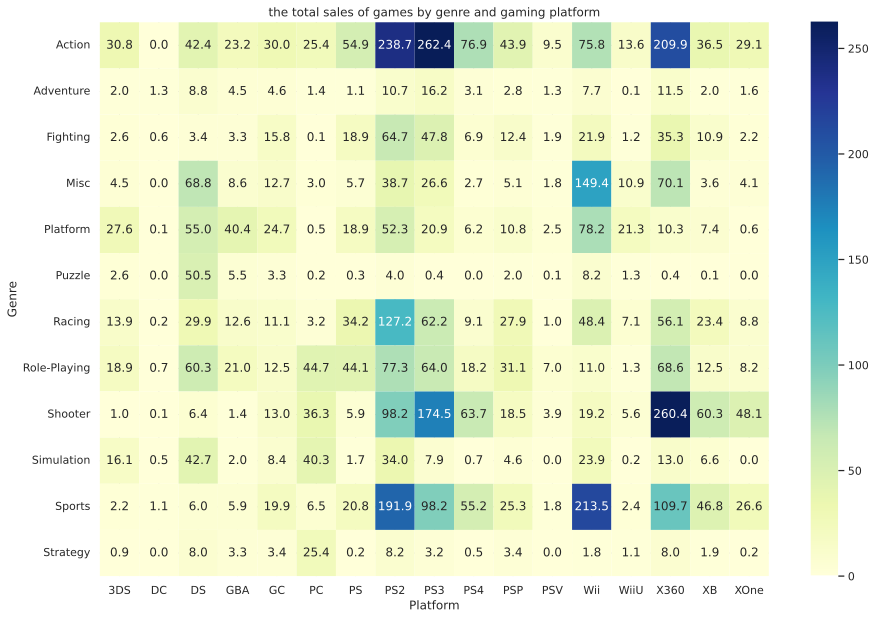

In [ ]:
a1 = df.pivot_table(values='Global_Sales', index='Genre', columns='Platform', aggfunc='sum', fill_value=0)
plt.figure(figsize=(15,10))
sns.heatmap(a1, annot=True, fmt=".1f", cmap="YlGnBu")
plt.title('the total sales of games by genre and gaming platform')
plt.xlabel('Platform')
plt.ylabel('Genre')

### Your answer to Q2.7:
The plot shows that which genres are popular on which platforms, based on total sales(darker shades represent higher sales, while lighter shades indicate lower sales). Darker cells demonstrate a high preference for genres on specific platforms. This plot shows that comparison between different platforms. For example, we can see uniform distribution of sales across genres of some platforms. Additionally, like platforms, Some genres are popular across most platforms than others. All in all, this plot shows that strengthen points and opportunities for market.